# LDM (latent diffusion model) Handler

In [1]:
from scsd.ldmhelper import LDMHelper

/home/skim/.pyenv/versions/sd/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
ldm = LDMHelper(mode="turbo")

INFO:LDMHelper:output folder: /mnt/transfer/sd-output


2024-01-12 22:56:46,824|pipeline|set_pipeline 41: INFO|1748189|load default ldm_info: turbo
2024-01-12 22:56:46,826|pipeline|load_components 190: INFO|1748189|torch dtype: float16
2024-01-12 22:56:47,048|pipeline|load_components 197: INFO|1748189|vae id: madebyollin/sdxl-vae-fp16-fix


Loading pipeline components...: 100%|████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 11.80it/s]


2024-01-12 22:56:48,771|pipeline|load_components 211: INFO|1748189|hfmodel id: stabilityai/sdxl-turbo
2024-01-12 22:56:48,771|pipeline|load_components 225: INFO|1748189|refiner id: 
2024-01-12 22:56:48,773|pipeline|load_components 231: INFO|1748189|img2img: True
2024-01-12 22:56:48,773|pipeline|load_components 242: INFO|1748189|compel: True
2024-01-12 22:56:48,773|pipeline|load_components 247: INFO|1748189|load pipeline: 1.95 sec


In [3]:
print(len(ldm.db))
ldm.clean_db()
print(len(ldm.db))

508
508


In [4]:
ldm.db.head()

,hfmodel_id,init_index,num_inference_steps,prompt_style,lora_scale,optimize,prompt,negative_prompt,guidance_scale,enable_compel,...,output_file_path,lora_list,use_compel,mode,refiner_id,scheduler_id,vae_id,torch_dtype,denoising_end,enable_img2img
0,stabilityai/sdxl-turbo,0,4,,0.0,True,a cinematic shot of a brave tiger (swimming)0....,,0.0,True,...,/mnt/transfer/sd-output/tiger/H512W512-tiger-S...,,True,turbo,,,None,None,NaN,None
1,stabilityai/sdxl-turbo,0,4,,0.0,True,a cinematic shot of a brave tiger (swimming)0....,,0.0,True,...,/mnt/transfer/sd-output/tiger/H512W512-tiger-S...,,True,turbo,,,None,None,NaN,None
2,stabilityai/sdxl-turbo,0,4,,0.0,True,a cinematic shot of a brave tiger (swimming)0....,,0.0,True,...,/mnt/transfer/sd-output/tiger/H512W512-tiger-S...,,True,turbo,,,None,None,NaN,None
3,stabilityai/sdxl-turbo,0,4,,0.0,True,a cinematic shot of a brave tiger (swimming)0....,,0.0,True,...,/mnt/transfer/sd-output/tiger/H512W512-tiger-S...,,True,turbo,,,None,None,NaN,None
4,stabilityai/sdxl-turbo,0,4,,0.0,True,a cinematic shot of a brave tiger (swimming)0....,,0.0,True,...,/mnt/transfer/sd-output/tiger/H512W512-tiger-S...,,True,turbo,,,None,None,NaN,None


2024-01-12 22:57:05,453|pipeline|_get_batch_inputs 105: INFO|1748189|input_dict: {'prompt': 'a golden vase with different flowers', 'negative_prompt': '', 'initial seed': 0, 'batch_size': 8, 'num_inference_steps': 4, 'guidance_scale': 0.0}


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:02<00:00,  1.77it/s]
INFO:LDMHelper:Time: 5.44 sec, Write to: /mnt/transfer/sd-output/sd_db.parquet


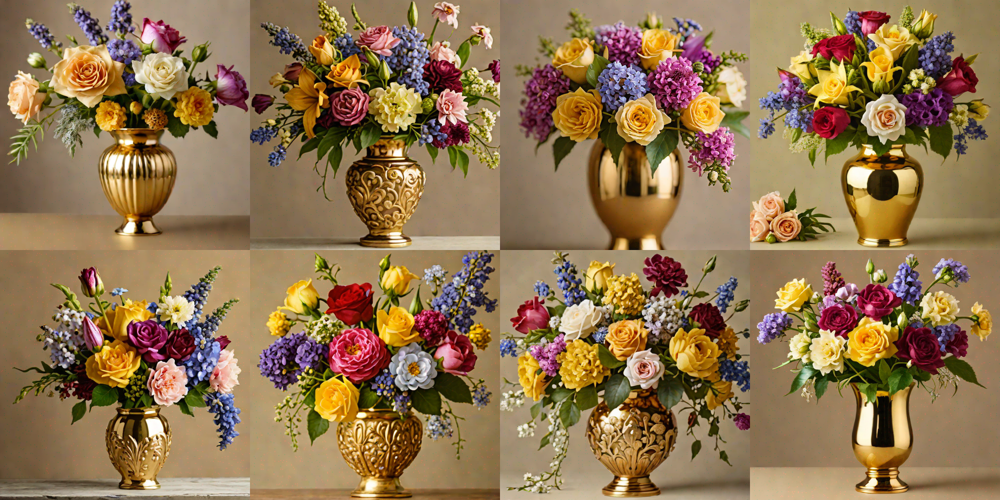

In [3]:
prompt = "a golden vase with different flowers"

ldm.txt2img(prompt, topic="vase", init_index=0, mode="turbo", batch_size=8)

In [10]:
prompt = "Design a high-resolution mockup of a professional curriculum vitae (CV). The CV should have a modern, geometric layout with sharp, clean lines, and a color scheme incorporating shades of teal and white. It should include a prominent header with the name and contact information, followed by sections for professional summary, skills, experience, education, and achievements. Use elegant, readable fonts and infographics for skill ratings. The background should be a subtle blend of the chosen color palette, with a clean design that draws attention to the content. Place the mockup on a wooden surface to give a realistic feel of a physical document, with a sleek white pen alongside for added professionalism."
ldm.ldm_info.negative_prompt = "multiple pages"
# prompt = "webapp, ui, ux, ui/ux, landing page, call for action, minimalist, blue, black and white, design, sharp, 4k"
# negative_prompt = "multiple page"


# ldm.txt2img(prompt, topic="merlin", mode="sdxl", batch_size=1, init_index=2)

Loading pipeline components...: 100%|████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 28.65it/s]
INFO:LDMHandler:input_dict: {'prompt': 'A propaganda poster of a golden retriever surfing on a longboard in Hawaii.', 'negative_prompt': '', 'batch_size': 1, 'num_inference_steps': 40, 'guidance_scale': 7.5}
100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:08<00:00,  1.11s/it]


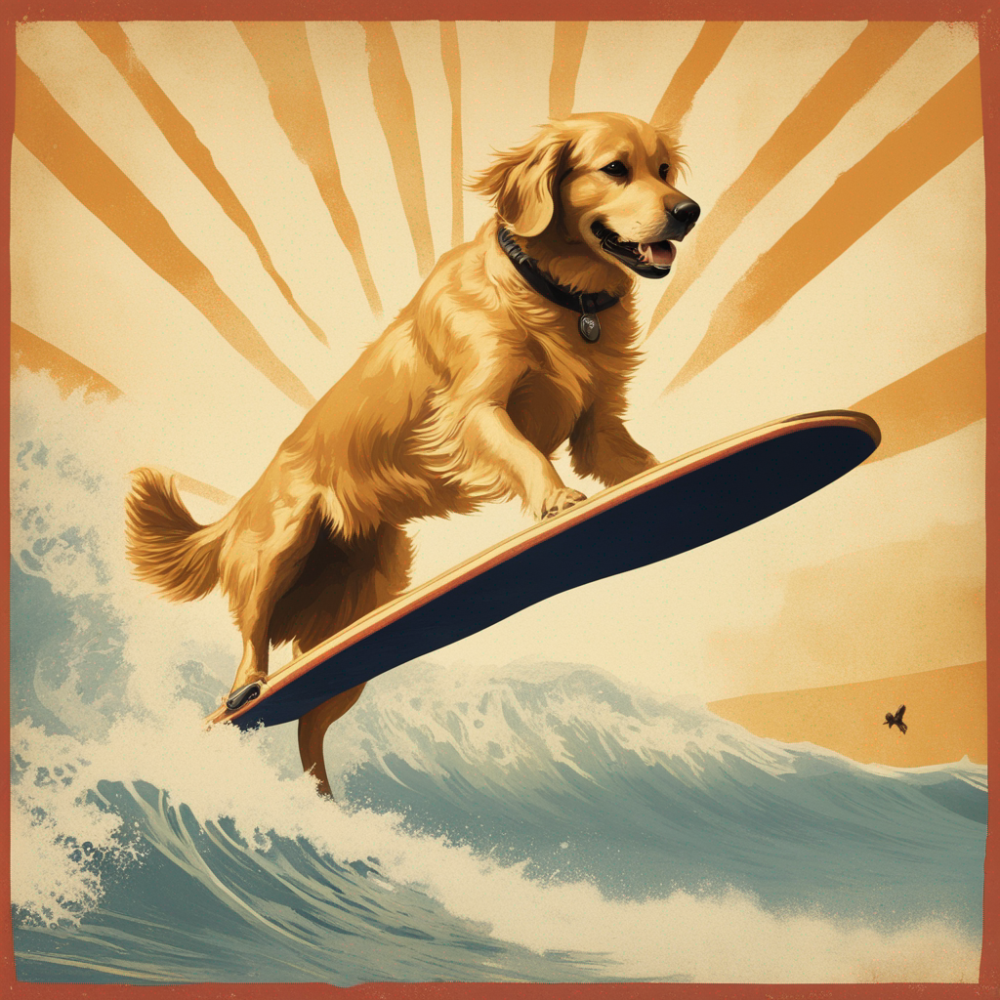

In [4]:
prompt = "A propaganda poster of a golden retriever surfing on a longboard in Hawaii."
# ldm.disable_freeu()
# ldm.txt2img(prompt, topic="retriever", init_index=80, batch_size=1, mode="sdxl")
ldm.ldm_info.guidance_scale = 7.5
ldm.refine(prompt)

Loading pipeline components...: 100%|████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 24.42it/s]
INFO:LDMHandler:input_dict: {'prompt': 'A propaganda poster of a golden retriever surfing on a longboard in Hawaii.', 'negative_prompt': '', 'batch_size': 1, 'num_inference_steps': 30, 'guidance_scale': 5.5}
100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:08<00:00,  1.23s/it]


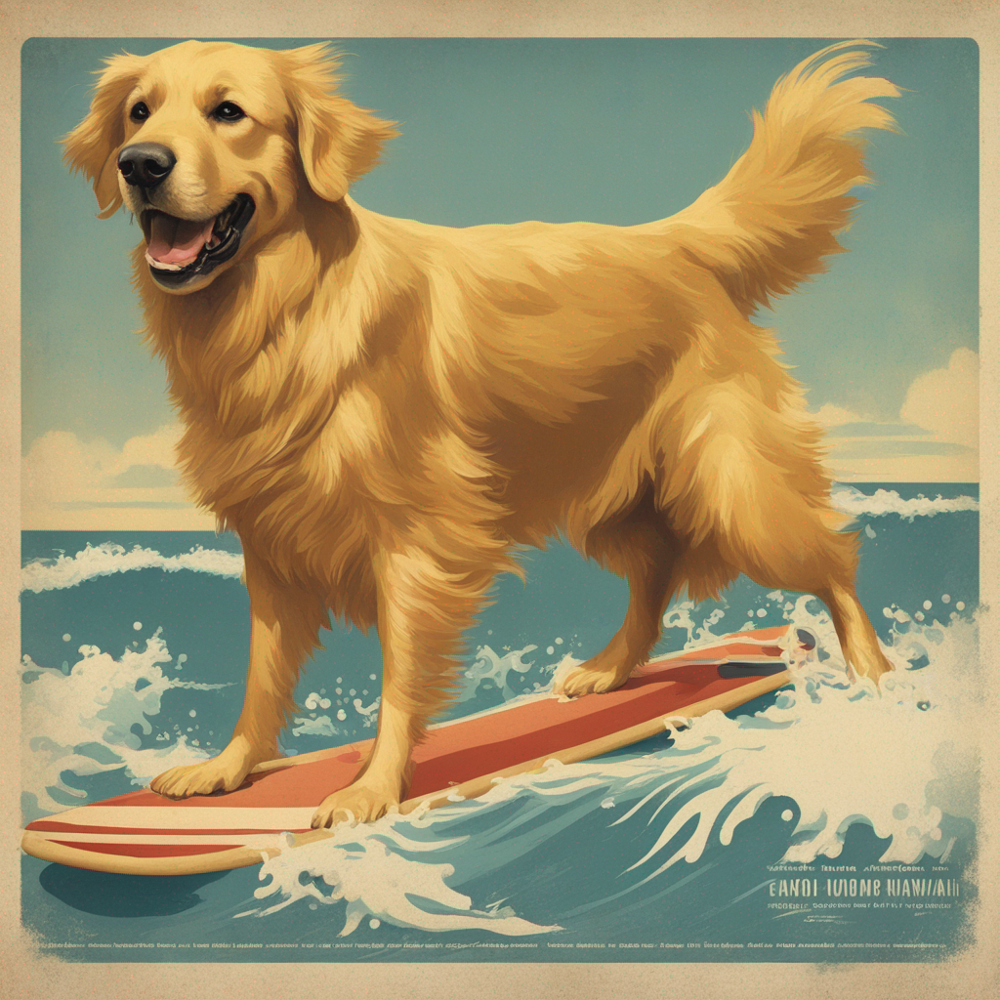

In [11]:
prompt = "A propaganda poster of a golden retriever surfing on a longboard in Hawaii."
ldm.ldm_info.guidance_scale = 5.5
ldm.ldm_info.init_index = 1
img = ldm.refine(prompt, num_inference_steps=30)
img.save("/mnt/transfer/sd-output/retriever/refine_1024_2_3.jpg")
img

In [11]:
ldm.disable_freeu()
# ldm.txt2img(prompt, output="tiger", init_index=0, batch_size=1)

In [12]:
prompt = "peasant and dragon combat, wood cutting style, viking era, bevel with rune"
# |ldm.txt2img(prompt, topic="woodcutting-peasant-dragon", init_index=0)

In [13]:
prompt = "a cinematic shot of a brave tiger swimming in a jungle"
ldm.set_scheduler("PNDM")
# ldm.txt2img(prompt, batch_size=2, topic="tiger", init_index=2, mode="sdxl")

INFO:LDMHandler:input file: /mnt/transfer/sd-output/kitten/kitten-H512-W512-I4.jpg
100%|██████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00,  2.56it/s]


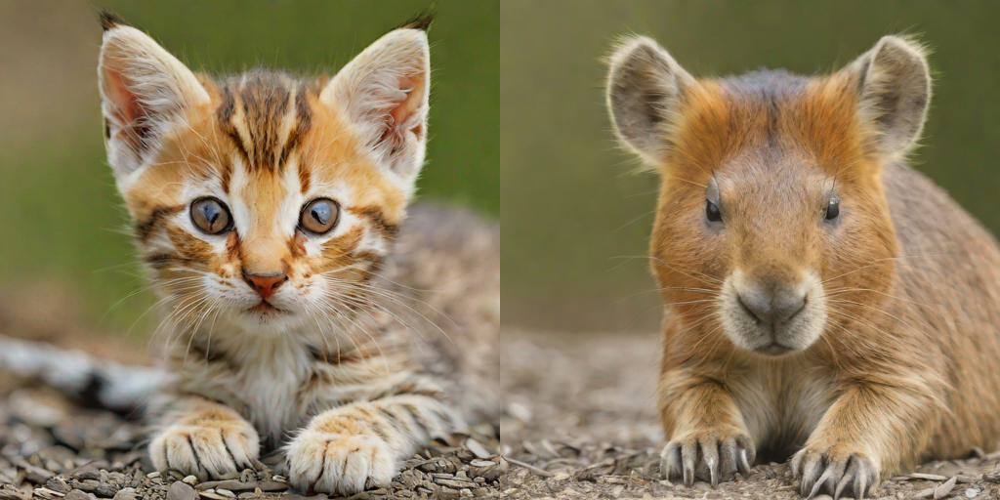

In [5]:
prompt = "a capybara"

# ldm = LDMHandler()
# ldm.generate(prompt, output="kitten")
ldm.img2img(prompt, output="kitten", index=3)

INFO:LDMHandler:input_dict: {'prompt': 'a cinematic shot of a chihuahua on a snowboard in the mountain.', 'negative_prompt': 'ugly, deformed, disfigured, poor details, bad anatomy', 'batch_size': 2, 'num_inference_steps': 20, 'guidance_scale': 0.0}
100%|████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:26<00:00,  1.33s/it]
INFO:LDMHandler:Time: 31.58 sec, Write to: /mnt/transfer/sd-output/sd_db.parquet


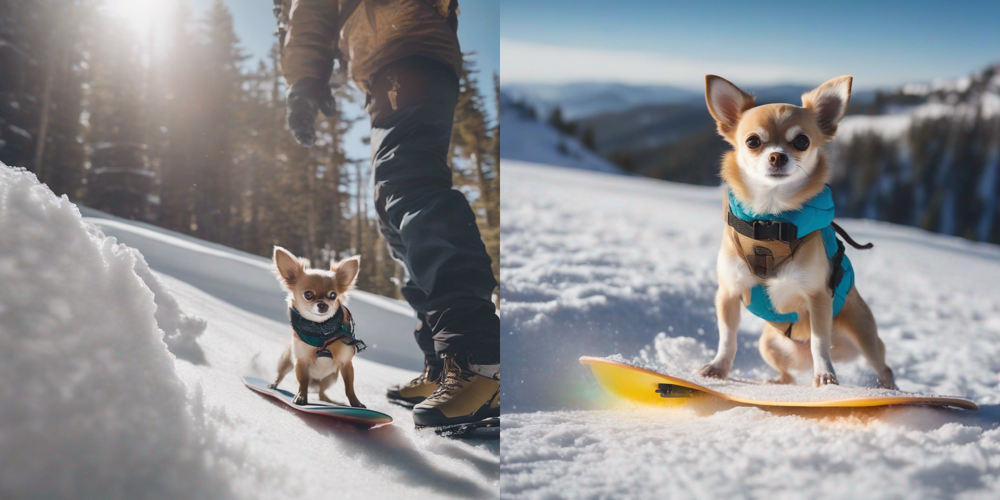

In [18]:
prompt = "a cinematic shot of a chihuahua on a snowboard in the mountain."
ldm.txt2img(prompt, topic="skiing_chihuahua", mode="sdxl", batch_size=2, init_index=0)

INFO:LDMHandler:lora: nerijs/pixel-art-xl name: pixel
INFO:LDMHandler:input_dict: {'prompt': 'pixel art, a cute corgi', 'negative_prompt': '3d render, realistic', 'batch_size': 8, 'num_inference_steps': 4, 'guidance_scale': 0.0}
100%|██████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:02<00:00,  1.35it/s]
INFO:LDMHandler:Time: 7.36 sec, Write to: /mnt/transfer/sd-output/sd_db.parquet


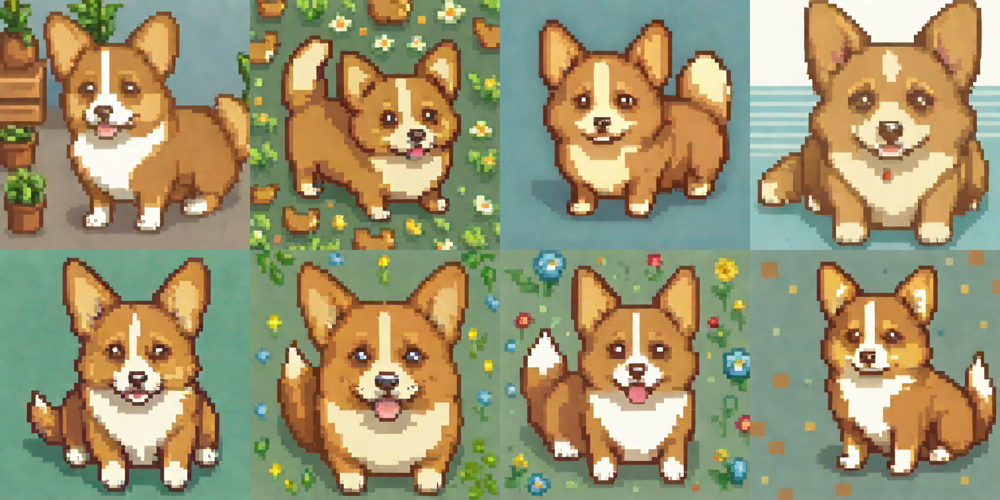

In [3]:
# use "pixel art" or "pixel with negative prompt"
ldm.load_lora_pixel()
ldm.txt2img("pixel art, a cute corgi", negative_prompt="3d render, realistic", topic="pixel_corgi")

/home/skim/.pyenv/versions/sd/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
100%|████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 41.91it/s]
/home/skim/.pyenv/versions/sd/lib/python3.10/site-packages/diffusers/pipelines/kandinsky2_2/pipeline_kandinsky2_2.py:202: FutureWarning: `callback_steps` is deprecated and will be removed in version 1.0.0. Passing `callback_steps` as an input argument to `__call__` is deprecated, consider use `callback_on_step_end`
  deprecate(
100%|██████████████████████████████████████████████████████████████████████████████████████| 100/100 [00:12<00:00,  7.78it/s]


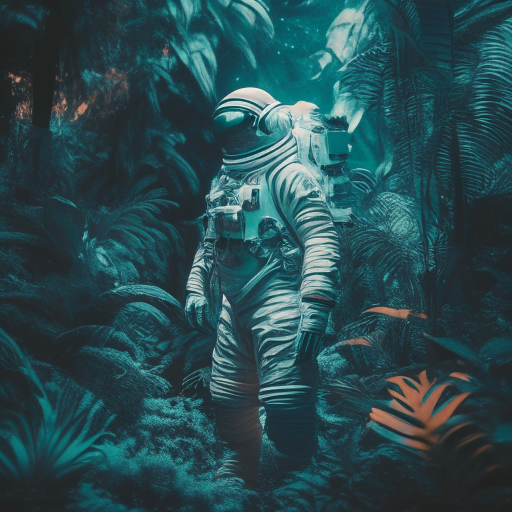

In [1]:
from diffusers import AutoPipelineForText2Image
import torch

pipeline = AutoPipelineForText2Image.from_pretrained(
    "kandinsky-community/kandinsky-2-2-decoder", torch_dtype=torch.float16
).to("cuda")
generator = torch.Generator("cuda").manual_seed(31)
image = pipeline("Astronaut in a jungle, cold color palette, muted colors, detailed, 8k", generator=generator).images[0]
image

In [14]:
prompt = "a boat in a sea dawn, masterpiece, in Hokusai style"
# ldm.load_lora_pixel()
ldm.disable_lora()
# ldm.txt2img(prompt, topic="boat_hokusai", init_index=16, mode="turbo")